In [1]:
import numpy as np
import imageio
import matplotlib.pyplot as plt
import matplotlib
import os
import glob
import torch

In [2]:
def coords_to_normals(coords):
    coords = torch.as_tensor(coords)
    if coords.ndim < 4:
        coords = coords[None]

    dxdu = coords[..., 0, :, 1:] - coords[..., 0, :, :-1]
    dydu = coords[..., 1, :, 1:] - coords[..., 1, :, :-1]
    dzdu = coords[..., 2, :, 1:] - coords[..., 2, :, :-1]
    dxdv = coords[..., 0, 1:, :] - coords[..., 0, :-1, :]
    dydv = coords[..., 1, 1:, :] - coords[..., 1, :-1, :]
    dzdv = coords[..., 2, 1:, :] - coords[..., 2, :-1, :]

    dxdu = torch.nn.functional.pad(dxdu, (0, 1),       mode='replicate')
    dydu = torch.nn.functional.pad(dydu, (0, 1),       mode='replicate')
    dzdu = torch.nn.functional.pad(dzdu, (0, 1),       mode='replicate')

    # pytorch cannot just do `dxdv = torch.nn.functional.pad(dxdv, (0, 0, 0, 1), mode='replicate')`, so
    dxdv = torch.cat([dxdv, dxdv[..., -1:, :]], dim=-2)
    dydv = torch.cat([dydv, dydv[..., -1:, :]], dim=-2)
    dzdv = torch.cat([dzdv, dzdv[..., -1:, :]], dim=-2)

    n_x = dydv * dzdu - dydu * dzdv
    n_y = dzdv * dxdu - dzdu * dxdv
    n_z = dxdv * dydu - dxdu * dydv

    n = torch.stack([n_x, n_y, n_z], dim=-3)
    n = torch.nn.functional.normalize(n, dim=-3)
    return n

def depth_to_absolute_coordinates(depth, depth_type, K, shift):

    depth = torch.as_tensor(depth)
    dtype = depth.dtype
    h, w = depth.shape[-2:]
    K = torch.as_tensor(K, dtype=dtype)

    v, u = torch.meshgrid(torch.arange(h, dtype=dtype) + shift, torch.arange(w, dtype=dtype) + shift)
    if depth.ndim < 3:  # ensure depth has channel dimension
        depth = depth[None]
    ones = torch.ones_like(v)
    points = torch.einsum('lk,kij->lij', K.inverse(), torch.stack([u, v, ones]))
    if depth_type == 'perspective':
        points = torch.nn.functional.normalize(points, dim=-3)
        points = points.to(depth) * depth
    elif depth_type == 'orthogonal':
        points = points / points[2:3]
        points = points.to(depth) * depth
    else:
        raise ValueError(f'Unknown type {depth_type}')
    return points

# Enhancement

In [8]:
vis_scene = ['scene0320_01_100', 'scene0507_00_900', 'scene0406_02_800', 'scene0213_00_1800', 'scene0331_00_1600']

jeon_path = '/all_data/vis/jeon_lee_enhancement/'
max_path = '/workspace/results/disc_depth/test/A2B/depth/'
methods = [jeon_path, max_path]
methods_name = ['Jeon and Lee', 'Max']

raw_path = '/all_data/Scannet_ssim/testA/full_size/depth/'
render_sr_path = '/all_data/Scannet_ssim/testB/full_size/depth/'
img_path = '/all_data/Scannet_ssim/testA/full_size/img/'

pred_depths = [[imageio.imread(os.path.join(dir, scene+'.png')) for scene in vis_scene] for dir in methods]
img = [imageio.imread(os.path.join(img_path, scene+'.jpg')) for scene in vis_scene]
raw = [imageio.imread(os.path.join(raw_path, scene+'.png')) for scene in vis_scene]
render = [imageio.imread(os.path.join(render_sr_path, scene+'.png')) for scene in vis_scene]

K = [np.loadtxt(os.path.join('/all_data/Scannet/', scene[:12], 'intrinsic', 'intrinsic_depth.txt'))[:3,:3] for scene in vis_scene]
raw_normals = [coords_to_normals(depth_to_absolute_coordinates(depth.astype(np.float64), 'orthogonal', K_, 0.5)) for depth, K_ in zip(raw, K)]
scale_K = np.array([[2., 1., 2.],[1., 2., 2.],[1., 1., 1.]])
render_normals = [coords_to_normals(depth_to_absolute_coordinates(depth.astype(np.float64), 'orthogonal',K_ * scale_K, 0.5)) for depth, K_ in zip(render, K)]
pred_normals = [[coords_to_normals(depth_to_absolute_coordinates(pred_depths[i][j].astype(np.float64), 'orthogonal',K[j] , 0.5)) for j in range(len(vis_scene))] for i in range(len(methods))]

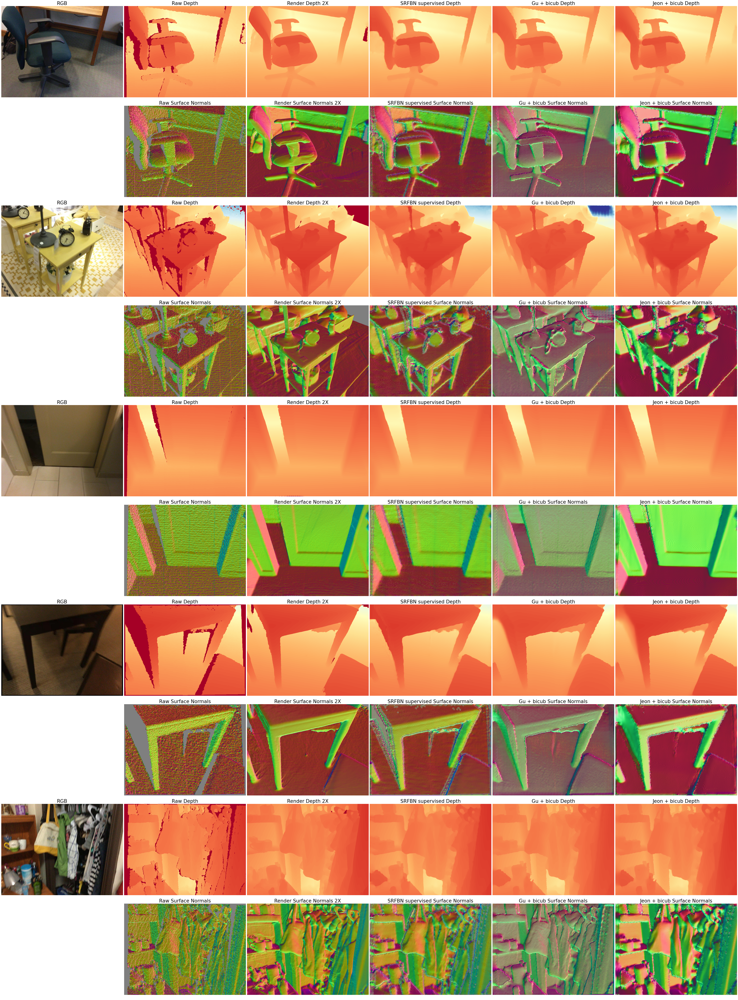

In [9]:
matplotlib.rcParams.update({'font.size': 22})
n_row = 2 * len(vis_scene)
n_col = len(methods) + 3
max_val = 5100
fig, axes = plt.subplots(n_row, n_col, figsize=(12 * n_col, 10 * n_row))
fig.subplots_adjust(hspace=0.01, wspace=0.01)
for i,ax in enumerate(axes.flatten()):
    ax.axis('off')
for i in range(len(vis_scene)):
    axes[2*i, 0].set_title('RGB')
    axes[2*i, 1].set_title('Raw Depth')
    axes[2*i, 2].set_title('Render Depth 2X')
    for j, name in enumerate(methods_name):
        axes[2*i, 3 + j].set_title(name + ' Depth')
    
    axes[2*i + 1, 0].set_title('')
    axes[2*i + 1, 1].set_title('Raw Surface Normals')
    axes[2*i + 1, 2].set_title('Render Surface Normals 2X')
    for j, name in enumerate(methods_name):
        axes[2*i + 1, 3 + j].set_title(name + ' Surface Normals')
    
    axes[2*i,0].imshow(img[i])
    axes[2*i,1].imshow(raw[i],cmap=plt.get_cmap('RdYlBu'), vmin=0, vmax=max_val)
    axes[2*i,2].imshow(render[i],cmap=plt.get_cmap('RdYlBu'), vmin=0, vmax=max_val)
    for j, name in enumerate(methods):
        axes[2*i, 3 + j].imshow(pred_depths[j][i],cmap=plt.get_cmap('RdYlBu'), vmin=0, vmax=max_val)

    axes[2*i + 1,1].imshow((raw_normals[i][0].permute(1,2,0).numpy() + 1.) / 2.)
    axes[2*i + 1,2].imshow((render_normals[i][0].permute(1,2,0).numpy() + 1.) / 2.)
    for j, name in enumerate(methods):
        axes[2*i + 1, 3 + j].imshow((pred_normals[j][i][0].permute(1,2,0).numpy() + 1.) / 2.)
plt.savefig('./enhancement.png')